Create a `HOME` constant.

In [1]:
import os
HOME = os.getcwd()
print("HOME:", HOME)

HOME: /Users/samuelstrong/Desktop/Mars_Research/segment-anything/notebooks


## Upload Image(s)

In [2]:
from PIL import Image
import cv2
import numpy as np

def process_image(image_path):
    # Read the image using OpenCV
    image = cv2.imread(image_path)
    
    # Verify if the image is loaded
    if image is None:
        print(f'Could not open or find the image: {image_path}')
        return None
    
    # Convert the OpenCV image to a PIL Image for easier manipulation
    image_pil = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    image_final = cv2.cvtColor(np.array(image_pil), cv2.COLOR_RGB2BGR)
    
    return image_final

In [3]:
import glob

# Path to the directory with images
imgs_path = '../dataset/img'

# Get a list of all jpeg files in the directory
imgs_files = glob.glob(os.path.join(imgs_path, '*.png'))

# Initialize an empty list to store the images
imgs = []

# Restrict how many
restrict = 0

# Loop over all files
for img_file in imgs_files:
    # Read the image
    img = process_image(img_file)

    # Verify if the image is loaded
    if img is None:
        print(f'Could not open or find the image: {img_file}')
    else:
        # Get the dimensions of the image
        # height, width, channels = img.shape

        imgs.append(img)

print(f"Successfully loaded {len(imgs)} images from {imgs_path}")

Successfully loaded 376 images from ../dataset/img


Make sure we imported right by displaying an image

(-0.5, 1647.5, 1199.5, -0.5)

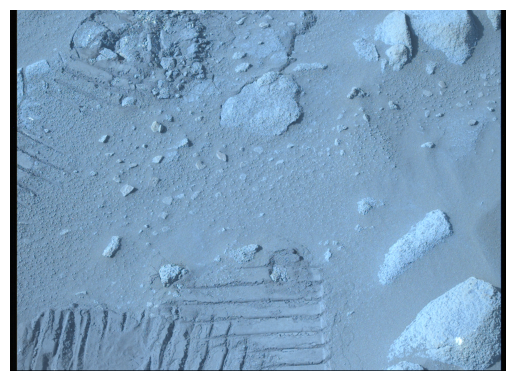

In [4]:
import matplotlib.pyplot as plt
import numpy as np
plt.imshow(imgs[16])
plt.axis('off')  # Hide the axis

### Results visualisation with Supervision

As of version `0.5.0` Supervision has native support for SAM.

In [5]:
image_path = '../dataset/img/ZL0_0385_0701130469_910EBY_N0140000ZCAM07115_1100LMJ02.png'
json_path = '../dataset/json/ZL0_0385_0701130469_910EBY_N0140000ZCAM07115_1100LMJ02.json'

10 34 vs 110 dataset comparison

In [219]:
import os
import random

images_path = '../dataset/img/'

count = 0

image_pairs = [
    {'34mm': 'ZL0_0352_0698200760_318EBY_N0095676ZCAM07114_0340LMJ02.png',
    '110mm': 'ZL0_0352_0698200846_318EBY_N0095676ZCAM07114_1100LMJ02.png'},
    
    {'110mm': 'ZL0_0359_0698822899_973EBY_N0100000ZCAM07115_1100LMJ02.png',
    '34mm':'ZL0_0359_0698822996_973EBY_N0100000ZCAM07115_0340LMJ02.png'},
    
    {'34mm': 'ZL0_0380_0700687229_988EBY_N0112472ZCAM07114_0340LMJ02.png',
    '110mm': 'ZL0_0380_0700687330_988EBY_N0112472ZCAM07114_1100LMJ02.png'},
    
    {'34mm': 'ZL0_0382_0700867252_909EBY_N0130000ZCAM07114_0340LMJ02.png',
    '110mm':'ZL0_0382_0700867338_910EBY_N0130000ZCAM07114_1100LMJ02.png'},
    
    {'34mm': 'ZL0_0383_0700954196_723EBY_N0131280ZCAM07114_0340LMJ02.png',
    '110mm':'ZL0_0383_0700954282_723EBY_N0131280ZCAM07114_1100LMJ02.png'},
    
    {'34mm': 'ZL0_0870_0744185434_081EBY_N0422266ZCAM07115_0340LMJ01.png',
    '110mm':'ZL0_0870_0744185398_081EBY_N0422266ZCAM07115_1100LMJ01.png'},
    
    {'110mm':'ZL0_0821_0739836703_318EBY_N0400132ZCAM07115_1100LMJ01.png',
    '34mm': 'ZL0_0821_0739836767_318EBY_N0400132ZCAM07115_0340LMJ01.png'},
    
    {'34mm': 'ZL0_0394_0701922945_803EBY_N0170000ZCAM07114_0340LMJ02.png',
    '110mm':'ZL0_0394_0701923040_803EBY_N0170000ZCAM07114_1100LMJ02.png'},
    
    {'34mm': 'ZL0_0926_0749156897_239EBY_N0450760ZCAM07114_0340LMJ01.png',
    '110mm':'ZL0_0926_0749156971_239EBY_N0450760ZCAM07114_1100LMJ02.png'},

    {'34mm':'ZL0_1006_0756258025_456EBY_N0481156ZCAM07114_0340LMJ01.png',
    '110mm':'ZL0_1006_0756258104_456EBY_N0481156ZCAM07114_1100LMJ01.png'},
]
# for filename in selected_images:
#     filename = filename[:-4]
#     image_json_pairs.append((f'../dataset/img/{filename}.png', f'../dataset/json/{filename}.json'))

In [232]:
import json
import math

def analyze_segments(filename):
    # Load JSON data
    filename = filename[:-4]
    json_path = f'../dataset/json/{filename}.json'
    with open(json_path, 'r') as file:
        data = json.load(file)
        
    # FOV angle in degrees for the height
    line_fov_deg = float(data['metadata']['line_fov'])

    # Distance to the floor in mm
    distance_to_floor = float(data['metadata']['focus_distance'])

    # Image height in pixels
    image_height_pix = 1200

    # Converting the FOV angle from degrees to radians
    line_fov_rad = math.radians(line_fov_deg)

    # Calculating the real-world height of the image
    real_world_height = 2 * math.tan(line_fov_rad / 2) * distance_to_floor

    # Calculating the height of one pixel
    height_per_pixel = real_world_height / image_height_pix


    # Extract information from JSON
    segments = data['segments']

    # Initialize lists for storing extracted details
    long_axes = []
    short_axes = []
    counted_areas = []
    angles = []
    aspect_ratios = []
    count = 0

    # Process each segment
    for segment in segments:
        count += 1
        bbox = segment['bbox']
        polygons = segment['polygon']
        area = segment['area']

        # Process each polygon in the segment
        for polygon in polygons:
            if len(polygon) >= 5 and area < 1000000:
                poly_pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
                ellipse = cv2.fitEllipse(poly_pts)
                (center_x, center_y), (major_axis, minor_axis), angle = ellipse
                angles.append(angle)
                
                # Calculate the endpoints of the long and short axes
                angle_rad = np.radians(angle)

                short_axes.append(major_axis*height_per_pixel)
                long_axes.append(minor_axis*height_per_pixel)
                counted_areas.append(area*height_per_pixel)
                aspect_ratios.append(major_axis/minor_axis)
                
    return {
        'total_segments': np.mean(count),
        'mean_major_axis (mm)': np.mean(long_axes), 
        'mean_minor_axis (mm)': np.mean(short_axes), 
        'mean_area (mm^2)': np.mean(counted_areas), 
        'mean_angle (deg)': np.mean(angles),
        'mean_aspect_ratio': np.mean(aspect_ratios),
        'median_major_axis (mm)': np.median(long_axes), 
        'median_minor_axis (mm)': np.median(short_axes), 
        'median_area (mm^2)': np.median(counted_areas), 
        'median_angle (deg)': np.median(angles),
        'median_aspect_ratio': np.median(aspect_ratios),
        'height_per_pix': height_per_pixel,
        'file_name': filename,
    }

In [233]:
pairs_results = []
for pair in image_pairs:
    new_entry = {}
    new_entry['110mm'] = analyze_segments(pair['110mm'])
    new_entry['34mm'] = analyze_segments(pair['34mm'])
    new_entry['difference'] = {}
    for (key, value) in new_entry['110mm'].items():
        if (key != 'file_name'):
            new_entry['difference'][key] = np.abs(value - new_entry['34mm'][key])
        else:
            new_entry['difference']['file_name'] = ""
    pairs_results.append(new_entry)

In [279]:

import cv2
import numpy as np
import json
import matplotlib.pyplot as plt

# Function to process and plot an image
def process_and_plot(image_path, json_path, pix_size, focal_length):
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError("Image not found at the specified path.")

    # Convert image to RGB for matplotlib display
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Load JSON data
    with open(json_path, 'r') as file:
        data = json.load(file)

    # Extract segments information
    segments = data['segments']

    # Process each segment
    for segment in segments:
        bbox = segment['bbox']
        polygons = segment['polygon']
        area = segment['area']

        for polygon in polygons:
            if len(polygon) >= 5 and area < 1000000:
                poly_pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
                ellipse = cv2.fitEllipse(poly_pts)
                (center_x, center_y), (major_axis, minor_axis), angle = ellipse

                angle_rad = np.radians(angle)
                cos_angle = np.cos(angle_rad)
                sin_angle = np.sin(angle_rad)

                half_major_axis = major_axis / 2
                half_minor_axis = minor_axis / 2

                start_long = (int(center_x - cos_angle * half_major_axis), int(center_y - sin_angle * half_major_axis))
                end_long = (int(center_x + cos_angle * half_major_axis), int(center_y + sin_angle * half_major_axis))

                start_short = (int(center_x + sin_angle * half_minor_axis), int(center_y - cos_angle * half_minor_axis))
                end_short = (int(center_x - sin_angle * half_minor_axis), int(center_y + cos_angle * half_minor_axis))

                # Draw the axes on the image
                cv2.line(img_rgb, start_long, end_long, (0, 0, 255), 2)
                cv2.line(img_rgb, start_short, end_short, (255, 0, 0), 2)
                cv2.polylines(img_rgb, [poly_pts], True, (0, 255, 0), 2)

    if (focal_length == 110):
        # Add a scale bar
        bar_length_mm = 50  # length of the scale bar in mm
        bar_length_px = int(bar_length_mm / pix_size)  # convert length to pixels

        # Coordinates for the scale bar
        bar_height = 10  # height of the scale bar in pixels
        bar_color = (255, 255, 0)  # yellow color for the scale bar

        # Bottom right corner of the image
        img_height, img_width, _ = img_rgb.shape
        start_x = img_width - bar_length_px - 20  # 20 pixels from the right edge
        start_y = img_height - bar_height - 20  # 20 pixels from the bottom edge
        end_x = img_width - 20  # end x-coordinate for the bar
        end_y = img_height - 20  # end y-coordinate for the bar

        # Draw the scale bar
        cv2.rectangle(img_rgb, (start_x, start_y), (end_x, end_y), bar_color, -1)
    else:
        # Add a scale bar
        bar_length_mm = 2  # length of the scale bar in mm
        bar_length_px = int(bar_length_mm / pix_size)  # convert length to pixels

        # Coordinates for the scale bar
        bar_height = 10  # height of the scale bar in pixels
        bar_color = (255, 255, 0)  # yellow color for the scale bar

        # Bottom right corner of the image
        img_height, img_width, _ = img_rgb.shape
        start_x = img_width - bar_length_px - 20  # 20 pixels from the right edge
        start_y = img_height - bar_height - 20  # 20 pixels from the bottom edge
        end_x = img_width - 20  # end x-coordinate for the bar
        end_y = img_height - 20  # end y-coordinate for the bar

        # Draw the scale bar
        cv2.rectangle(img_rgb, (start_x, start_y), (end_x, end_y), bar_color, -1)


    # Return the processed image
    return img_rgb


In [282]:
import textwrap
# Function to wrap text
def wrap_text(text, width):
    return '\n'.join(textwrap.wrap(text, width))



def render_side_by_side(img_rgb1, img_rgb2, title1, title2):
    # Create subplots with 1 row and 2 columns
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    

    # Display the second image
    axs[0].imshow(img_rgb2)
    axs[0].set_title("110.0mm Focal Length", fontsize=16, fontweight='bold')  # Main title
    axs[0].text(0.5, -0.15, title2, ha='center', fontsize=12, transform=axs[0].transAxes)
    axs[0].text(0.9, 0.06, "50mm", ha='center', color='yellow', fontsize=12, transform=axs[0].transAxes)
    axs[0].axis('off')  # Turn off the axis
    
    # Display the first image
    axs[1].imshow(img_rgb1)
    axs[1].set_title("34.0mm Focal Length", fontsize=16, fontweight='bold')  # Main title
    axs[1].text(0.5, -0.15, title1, ha='center', fontsize=12, transform=axs[1].transAxes)
    axs[1].text(0.9, 0.06, "2mm", ha='center', color='yellow', fontsize=12, transform=axs[1].transAxes)
    axs[1].axis('off')  # Turn off the axis
    
    
    # Adjust layout to avoid overlap
    plt.tight_layout()
    
    # Save the image to an in-memory buffer
    buffer = BytesIO()
    plt.savefig(buffer, format='png')
    plt.close(fig)
    buffer.seek(0)
    img_str = base64.b64encode(buffer.read()).decode('utf-8')
    img_html = f'<img src="data:image/png;base64,{img_str}" style="max-width: 100%;">'
    
    return img_html

RESULT FROM SOL: 0352


,110mm,34mm,difference
total_segments,168.0,156.0,12.0
mean_major_axis (mm),4.152916,0.126748,4.026167
mean_minor_axis (mm),2.773691,0.073089,2.700601
mean_area (mm^2),71.137114,18.315853,52.82126
mean_angle (deg),96.09312,100.044579,3.951458
mean_aspect_ratio,0.69812,0.67125,0.026871
median_major_axis (mm),3.745089,0.053706,3.691384
median_minor_axis (mm),2.502714,0.036766,2.465948
median_area (mm^2),49.564281,0.597652,48.966629
median_angle (deg),91.672337,102.073097,10.400761

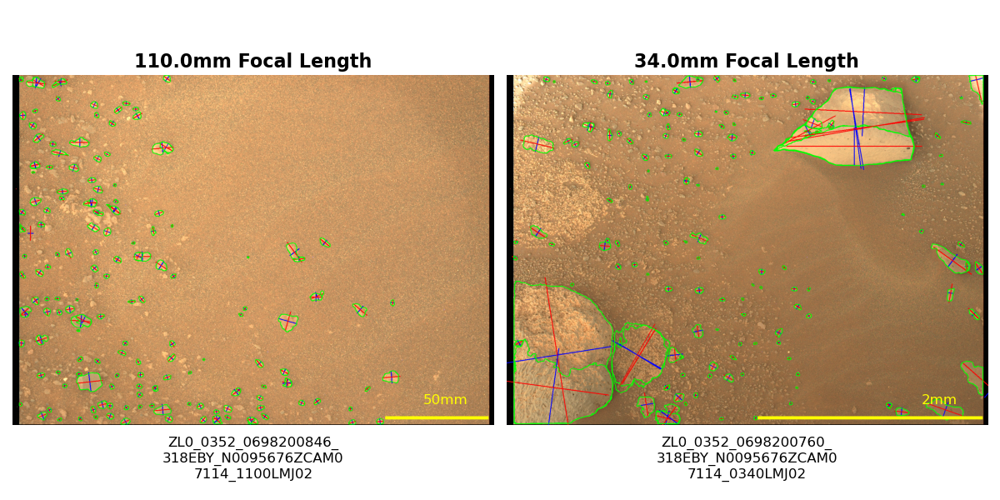




RESULT FROM SOL: 0359


,110mm,34mm,difference
total_segments,424.0,130.0,294.0
mean_major_axis (mm),3.390901,0.090386,3.300515
mean_minor_axis (mm),2.391447,0.031604,2.359843
mean_area (mm^2),49.765204,1.087643,48.677561
mean_angle (deg),90.556727,89.88912,0.667607
mean_aspect_ratio,0.729529,0.72145,0.00808
median_major_axis (mm),3.015053,0.040463,2.97459
median_minor_axis (mm),2.172893,0.028452,2.144441
median_area (mm^2),35.54467,0.340402,35.204269
median_angle (deg),89.774651,90.858868,1.084217

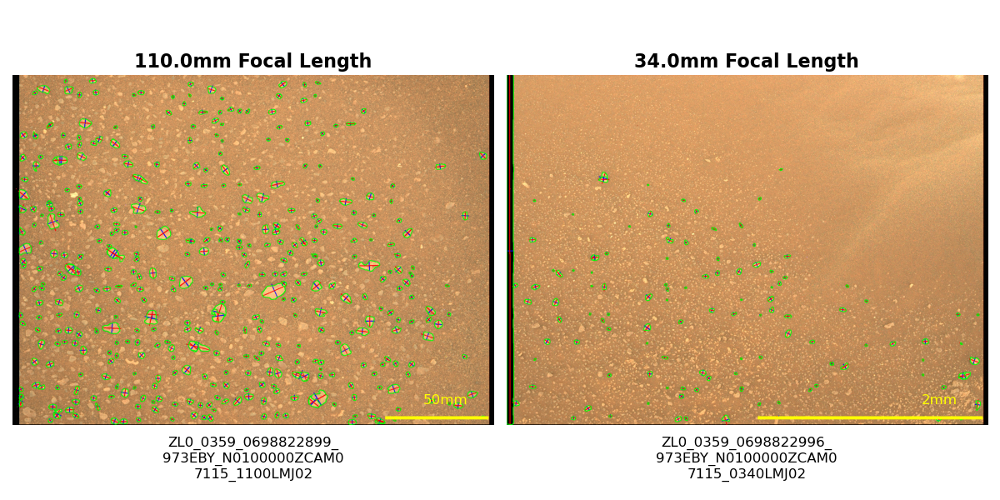




RESULT FROM SOL: 0380


,110mm,34mm,difference
total_segments,544.0,454.0,90.0
mean_major_axis (mm),5.234329,0.051643,5.182686
mean_minor_axis (mm),3.334111,0.035473,3.298638
mean_area (mm^2),121.236372,0.589322,120.64705
mean_angle (deg),96.662016,93.554239,3.107777
mean_aspect_ratio,0.688285,0.707943,0.019658
median_major_axis (mm),4.290036,0.046882,4.243154
median_minor_axis (mm),2.872177,0.033054,2.839123
median_area (mm^2),68.115484,0.462531,67.652953
median_angle (deg),97.312054,95.949776,1.362278

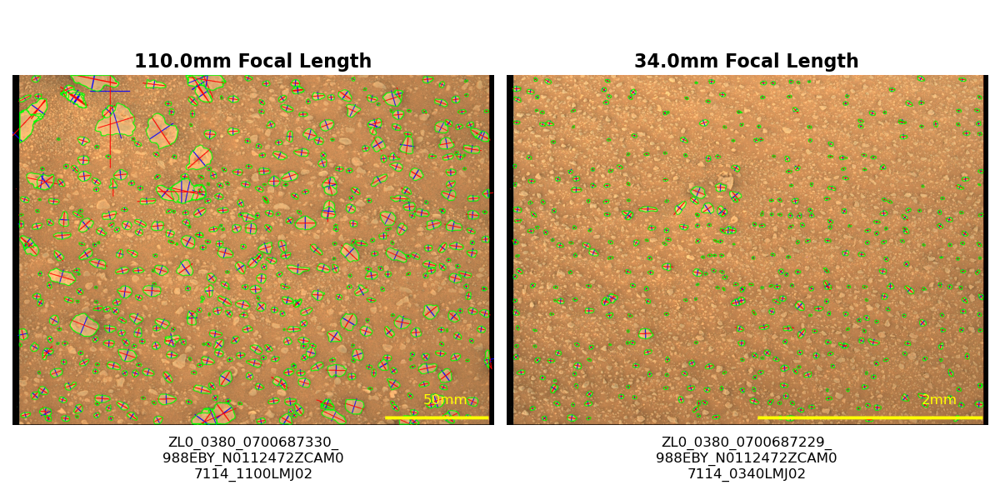




RESULT FROM SOL: 0382


,110mm,34mm,difference
total_segments,660.0,262.0,398.0
mean_major_axis (mm),4.126397,0.053064,4.073333
mean_minor_axis (mm),2.776808,0.035387,2.741421
mean_area (mm^2),69.10485,0.653625,68.451225
mean_angle (deg),91.782079,92.235445,0.453365
mean_aspect_ratio,0.704531,0.693125,0.011406
median_major_axis (mm),3.819076,0.045366,3.77371
median_minor_axis (mm),2.592163,0.030012,2.562152
median_area (mm^2),53.033781,0.39497,52.638811
median_angle (deg),93.351372,97.455215,4.103844

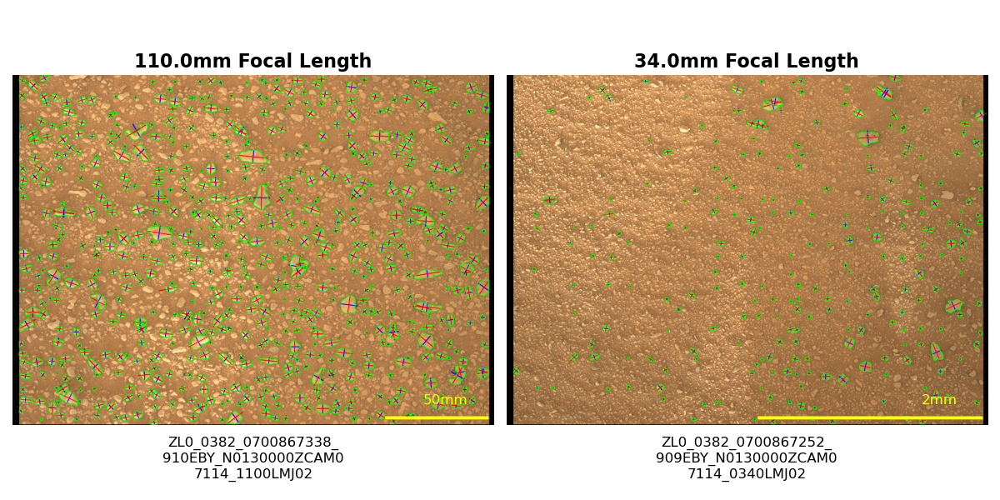




RESULT FROM SOL: 0383


,110mm,34mm,difference
total_segments,474.0,481.0,7.0
mean_major_axis (mm),5.734076,0.057535,5.67654
mean_minor_axis (mm),3.608996,0.039423,3.569573
mean_area (mm^2),143.95471,0.731496,143.223215
mean_angle (deg),88.653766,90.753251,2.099485
mean_aspect_ratio,0.677018,0.700853,0.023835
median_major_axis (mm),5.098495,0.052717,5.045778
median_minor_axis (mm),3.316993,0.036639,3.280355
median_area (mm^2),90.277798,0.563872,89.713926
median_angle (deg),90.601707,90.717854,0.116146

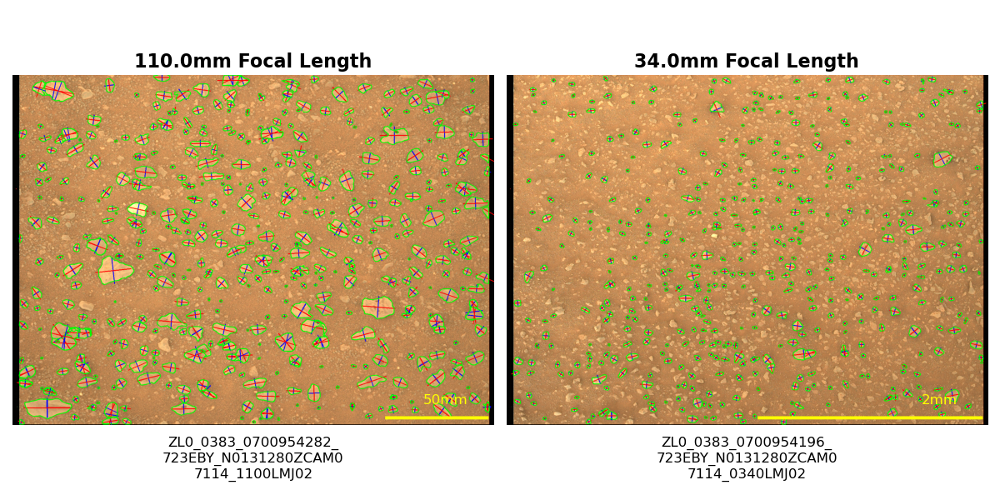




RESULT FROM SOL: 0870


,110mm,34mm,difference
total_segments,479.0,252.0,227.0
mean_major_axis (mm),5.123728,0.972562,4.151166
mean_minor_axis (mm),3.43085,0.579787,2.851063
mean_area (mm^2),124.147207,21.081742,103.065466
mean_angle (deg),91.03185,91.1236,0.09175
mean_aspect_ratio,0.707626,0.715226,0.007599
median_major_axis (mm),4.110192,0.593703,3.516489
median_minor_axis (mm),2.839916,0.418612,2.421304
median_area (mm^2),62.521801,7.197809,55.323991
median_angle (deg),91.357414,92.500031,1.142616

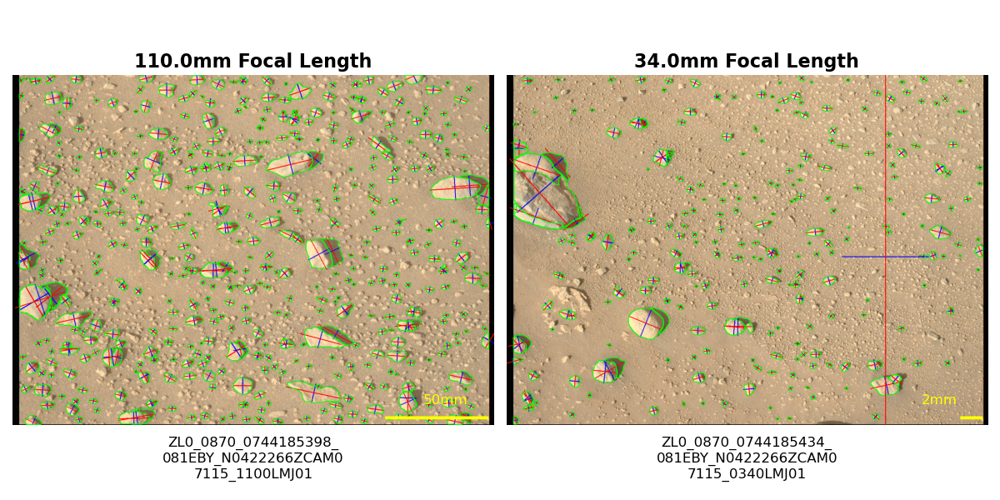




RESULT FROM SOL: 0821


,110mm,34mm,difference
total_segments,177.0,155.0,22.0
mean_major_axis (mm),6.523183,0.903637,5.619546
mean_minor_axis (mm),4.223334,0.624168,3.599166
mean_area (mm^2),1247.592286,35.72954,1211.862746
mean_angle (deg),96.648424,93.093306,3.555119
mean_aspect_ratio,0.72868,0.739675,0.010995
median_major_axis (mm),3.47643,0.511255,2.965175
median_minor_axis (mm),2.678883,0.388815,2.290067
median_area (mm^2),53.812648,5.59974,48.212909
median_angle (deg),100.579605,91.606052,8.973553

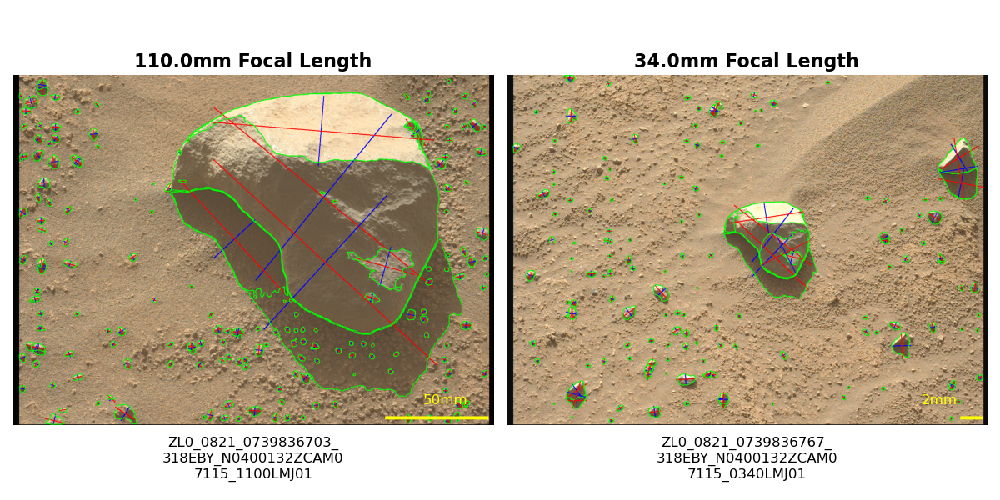




RESULT FROM SOL: 0394


,110mm,34mm,difference
total_segments,667.0,242.0,425.0
mean_major_axis (mm),3.984975,0.057096,3.927879
mean_minor_axis (mm),2.747259,0.039239,2.70802
mean_area (mm^2),85.502554,0.77803,84.724523
mean_angle (deg),82.496821,78.552306,3.944514
mean_aspect_ratio,0.71703,0.721131,0.004101
median_major_axis (mm),3.524818,0.047251,3.477567
median_minor_axis (mm),2.496049,0.034495,2.461554
median_area (mm^2),46.023976,0.466428,45.557547
median_angle (deg),80.927513,79.212273,1.71524

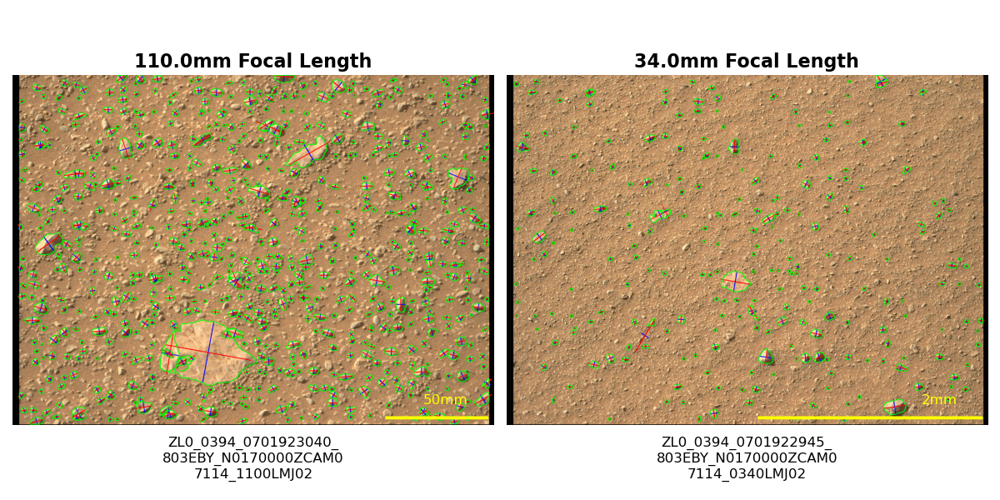




RESULT FROM SOL: 0926


,110mm,34mm,difference
total_segments,210.0,282.0,72.0
mean_major_axis (mm),7.354093,0.858431,6.495661
mean_minor_axis (mm),4.114663,0.521171,3.593492
mean_area (mm^2),380.639257,38.445429,342.193829
mean_angle (deg),90.228273,87.973539,2.254734
mean_aspect_ratio,0.651822,0.697604,0.045781
median_major_axis (mm),5.066871,0.619765,4.447107
median_minor_axis (mm),3.303199,0.420411,2.882788
median_area (mm^2),94.80939,7.977355,86.832034
median_angle (deg),88.477589,92.091393,3.613804

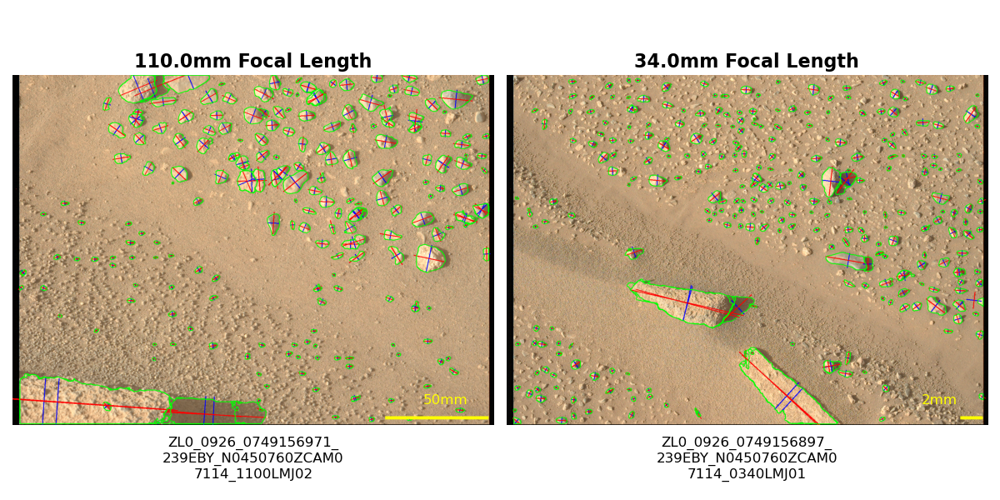




RESULT FROM SOL: 1006


,110mm,34mm,difference
total_segments,96.0,156.0,60.0
mean_major_axis (mm),14.366115,2.055939,12.310176
mean_minor_axis (mm),6.795716,1.200663,5.595053
mean_area (mm^2),2313.103384,124.342643,2188.760741
mean_angle (deg),97.584276,90.525057,7.059219
mean_aspect_ratio,0.633255,0.611426,0.02183
median_major_axis (mm),4.136327,1.487653,2.648675
median_minor_axis (mm),2.740067,0.800118,1.939949
median_area (mm^2),106.138368,32.052338,74.08603
median_angle (deg),95.200375,89.874611,5.325764

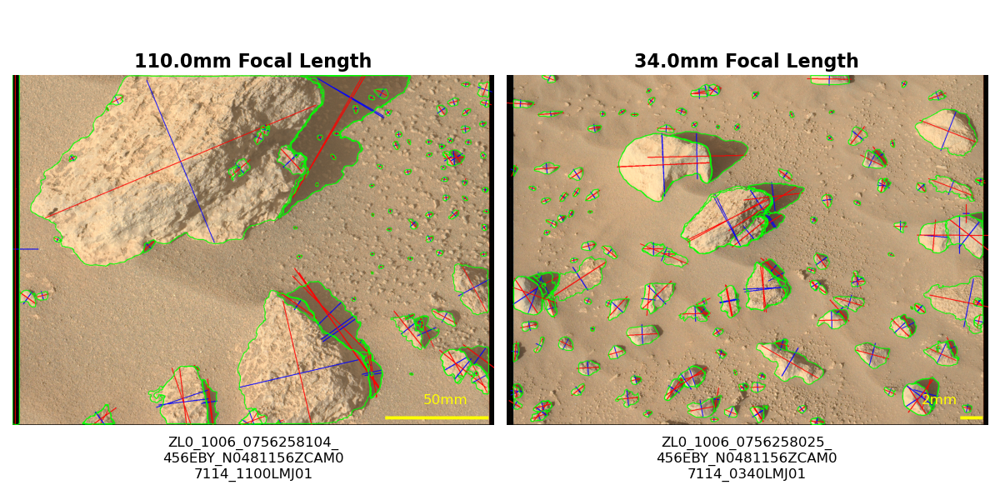

In [283]:
import pandas as pd
from IPython.display import display, HTML
import copy

for result in pairs_results:
    print("RESULT FROM SOL: " + result['110mm']['file_name'][4:8])
    result_copy = result.copy()
    df = pd.DataFrame(result_copy)
    
    # Generate the image paths
    image_path1 = f"../dataset/img/{df['34mm']['file_name']}.png"
    json_path1 = f"../dataset/json/{df['34mm']['file_name']}.json"
    image_path2 = f"../dataset/img/{df['110mm']['file_name']}.png"
    json_path2 = f"../dataset/json/{df['110mm']['file_name']}.json"

    df.loc['file_name'] = df.loc['file_name'].apply(lambda x: wrap_text(x, 20))
    
    # Process the image
    img_rgb1 = process_and_plot(image_path1, json_path1, result['34mm']['height_per_pix'], 34)
    img_rgb2 = process_and_plot(image_path2, json_path2, result['110mm']['height_per_pix'], 110)
    
    img_html = render_side_by_side(img_rgb1, img_rgb2, df['34mm']['file_name'], df['110mm']['file_name'])
    
    new_df = copy.deepcopy(df)
    new_df = new_df.drop(index='file_name')
    new_df = new_df.drop(index='height_per_pix')
    df_html = new_df.to_html(escape=False)
    # Create the combined display of the DataFrame and the image
    html = f"""
    <div style="display: flex; align-items: flex-start;">
        <div style="flex: 1; display: flex; align-items: center; justify-content: center; width: 20%; height: 347px; overflow: auto; border: 2px solid black; background: #aaa">
        <div style="margin:auto; background: #333;">
            {df_html}
        </div>
        </div>
        <div style="flex: 1; width: 80%">
            {img_html}
        </div>
    </div>
    """
    
    display(HTML(html))
    print("\n\n")

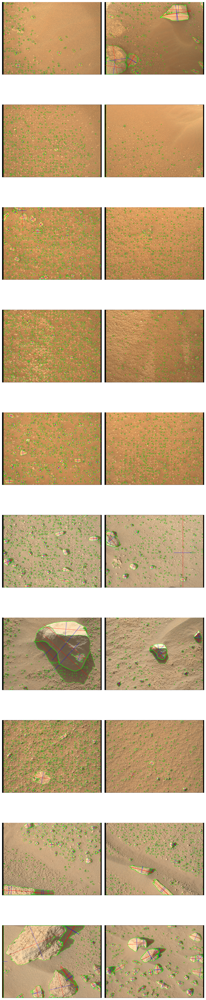

In [119]:

import cv2
import numpy as np
import json
import matplotlib.pyplot as plt

# Placeholder paths for images and JSON files
images110_paths = [pair[0] for pair in selected_110]  # Update these paths
images34_paths = [pair[0] for pair in selected_34]  # Update these paths
json110_paths = [pair[1] for pair in selected_110]  # Update these paths
json34_paths = [pair[1] for pair in selected_34]  # Update these paths


total_rows = max(len(images110_paths), len(images34_paths))

# Initialize matplotlib plot grid
fig, axes = plt.subplots(nrows=total_rows, ncols=2, figsize=(10, 5 * total_rows))

# Function to process and plot an image
def process_and_plot(image_path, json_path, ax):
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError("Image not found at the specified path.")

    # Convert image to RGB for matplotlib display
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Load JSON data
    with open(json_path, 'r') as file:
        data = json.load(file)

    # Extract segments information
    segments = data['segments']

    # Process each segment
    for segment in segments:
        bbox = segment['bbox']
        polygons = segment['polygon']
        area = segment['area']

        for polygon in polygons:
            if len(polygon) >= 5 and area < 1000000:
                poly_pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
                ellipse = cv2.fitEllipse(poly_pts)
                (center_x, center_y), (major_axis, minor_axis), angle = ellipse

                angle_rad = np.radians(angle)
                cos_angle = np.cos(angle_rad)
                sin_angle = np.sin(angle_rad)

                half_major_axis = major_axis / 2
                half_minor_axis = minor_axis / 2

                start_long = (int(center_x - cos_angle * half_major_axis), int(center_y - sin_angle * half_major_axis))
                end_long = (int(center_x + cos_angle * half_major_axis), int(center_y + sin_angle * half_major_axis))

                start_short = (int(center_x + sin_angle * half_minor_axis), int(center_y - cos_angle * half_minor_axis))
                end_short = (int(center_x - sin_angle * half_minor_axis), int(center_y + cos_angle * half_minor_axis))

                # Draw the axes on the image
                cv2.line(img_rgb, start_long, end_long, (0, 0, 255), 2)
                cv2.line(img_rgb, start_short, end_short, (255, 0, 0), 2)
                cv2.polylines(img_rgb, [poly_pts], True, (0, 255, 0), 2)

    # Display the image
    ax.imshow(img_rgb)
    ax.axis('off')

# Plot images side by side, alternating between 110 and 34
for i in range(total_rows):
    if i < len(images110_paths) and i < len(images34_paths):
        process_and_plot(images110_paths[i], json110_paths[i], axes[i, 0])
        process_and_plot(images34_paths[i], json34_paths[i], axes[i, 1])
    elif i < len(images110_paths):
        process_and_plot(images110_paths[i], json110_paths[i], axes[i, 0])
        axes[i, 1].axis('off')  # Turn off axis if no image is present
    elif i < len(images34_paths):
        process_and_plot(images34_paths[i], json34_paths[i], axes[i, 1])
        axes[i, 0].axis('off')  # Turn off axis if no image is present

plt.tight_layout()
plt.show()

# add zooms and image IDs for each

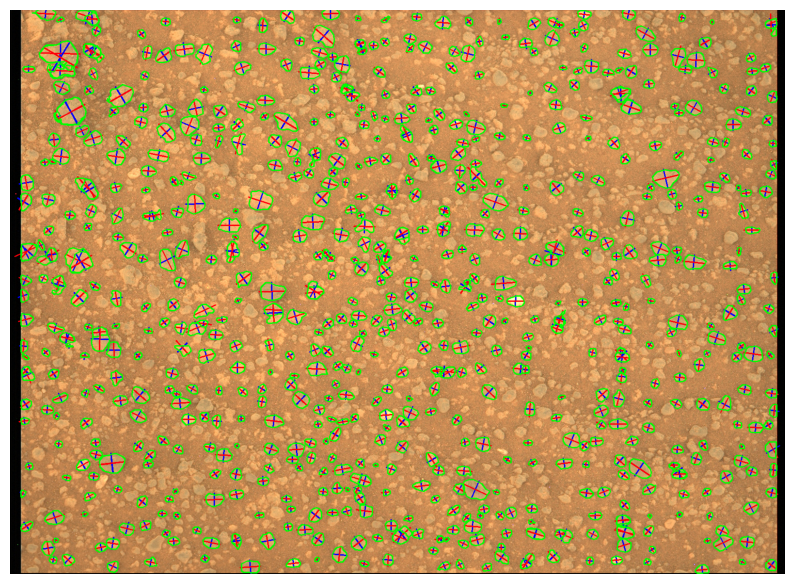

In [13]:
import json
# Load the image
img = cv2.imread(image_path)
if img is None:
    raise FileNotFoundError("Image not found at the specified path.")

# Convert image to RGB for matplotlib display
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Load JSON data
with open(json_path, 'r') as file:
    data = json.load(file)

# Extract information from JSON
segments = data['segments']

# Initialize lists for storing extracted details
long_axes = []
short_axes = []
counted_areas = []
angles = []

# Process each segment
for segment in segments:
    bbox = segment['bbox']
    polygons = segment['polygon']
    area = segment['area']

    # Process each polygon in the segment
    for polygon in polygons:
        if len(polygon) >= 5 and area < 1000000:
            poly_pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
            ellipse = cv2.fitEllipse(poly_pts)
            (center_x, center_y), (major_axis, minor_axis), angle = ellipse
            
            # Calculate the endpoints of the long and short axes
            angle_rad = np.radians(angle)
            cos_angle = np.cos(angle_rad)
            sin_angle = np.sin(angle_rad)
            
            half_major_axis = major_axis / 2
            half_minor_axis = minor_axis / 2
            short_axes.append(half_major_axis)
            long_axes.append(half_minor_axis)
            counted_areas.append(area)
            
            start_long = (int(center_x - cos_angle * half_major_axis), int(center_y - sin_angle * half_major_axis))
            end_long = (int(center_x + cos_angle * half_major_axis), int(center_y + sin_angle * half_major_axis))
            
            start_short = (int(center_x + sin_angle * half_minor_axis), int(center_y - cos_angle * half_minor_axis))
            end_short = (int(center_x - sin_angle * half_minor_axis), int(center_y + cos_angle * half_minor_axis))
            
            # Draw the axes on the image with a smaller line width
            cv2.line(img_rgb, start_long, end_long, (0, 0, 255), 2)  # Red for long axis
            cv2.line(img_rgb, start_short, end_short, (255, 0, 9), 2)  # Blue for short axis
            
            # Draw the polygon in green:
            cv2.polylines(img_rgb, [poly_pts], True, (0, 255, 0), 2)

# Show the image with overlays
plt.figure(figsize=(10, 10))
plt.imshow(img_rgb)
plt.axis('off')
plt.show()

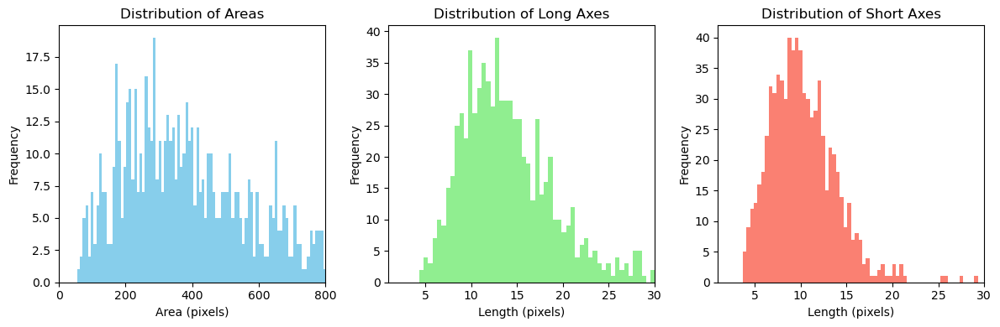

In [14]:
# Assuming you have collected 'areas', 'long_axes', and 'short_axes' data for all segments across images
# For demonstration, let's create some sample data

import numpy as np
import matplotlib.pyplot as plt

# Plotting the distribution of areas
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.hist(counted_areas, bins=500, color='skyblue')
plt.title('Distribution of Areas')
plt.xlabel('Area (pixels)')
plt.ylabel('Frequency')
plt.xlim(0, 800)

# Plotting the distribution of long axes
plt.subplot(1, 3, 2)
plt.hist(long_axes, bins=80, color='lightgreen')
plt.title('Distribution of Long Axes')
plt.xlabel('Length (pixels)')
plt.ylabel('Frequency')
plt.xlim(1, 30)

# Plotting the distribution of short axes
plt.subplot(1, 3, 3)
plt.hist(short_axes, bins=80, color='salmon')
plt.title('Distribution of Short Axes')
plt.xlabel('Length (pixels)')
plt.ylabel('Frequency')
plt.xlim(1, 30)

plt.tight_layout()
plt.show()


In [15]:
import pandas as pd

# Create a DataFrame from the series
data = pd.DataFrame({'Areas': counted_areas, 'Long Axes': long_axes, 'Short Axes': short_axes})

# Print summary statistics for all three
print(data.describe())


             Areas   Long Axes  Short Axes
count   749.000000  749.000000  749.000000
mean    486.575434   14.029183   10.250743
std     391.545278    5.177385    3.647271
min      55.000000    4.347765    3.683035
25%     257.000000   10.245184    7.666304
50%     389.000000   13.105140    9.767472
75%     607.000000   16.881617   12.231211
max    4117.000000   43.138645   36.255306
